In [19]:
# import packages
import os
import six
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib import colors as clrs
import matplotlib.transforms as transforms
import numpy as np
import scanpy as sc
import glob
import anndata as an
import seaborn as sns
from tqdm.notebook import tqdm
from random import sample
from anndata import AnnData
from dask.base import get_name_from_key
from IPython.display import IFrame

In [2]:
# remove warnings
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

In [3]:
# print package versions
import session_info
session_info.show()

# Variables, Info, and Data Paths

In [4]:
# number of degrees to turn each of the regions in order to orient them in the same way, used later 
transform_degrees = {
    '1_0': 35,
    '2_0': 35 + 270,
    '2_1': 35 + 270,
    '4_0': 35 + 180,
    '4_1': 35 + 180,
    '6_0': 35 + 180,
    '6_1': 35 + 180
}
# regions refer to each individual tissue section
regions_list = ['1_0','2_0','2_1','4_0','4_1','6_0','6_1']

# gene lists 
neuron_gene_list = 'Ascl1,Nkx2-2,Foxn4,Nrxn3,Megf11,Ret,Nrxn1,Lhx2,Lhx4,Neurog3,Uncx,Hmx2,Hmx3,Bhlhe23,Lhx1,Cbln1,Lhx3,Barhl2,Tlx3,Otp,Pax8,Lbx1,Pax2,Bhlhe22,Slc10a4,Slc18a3,Evx1,Vsx2,Sox14,Vsx1,Onecut2,Pou2f2,Tubb3,Elavl3'.split(',')
mesoderm_gene_list = 'Foxc1,Foxc2,Meox1,Meox2,Myog'.split (',')
neural_crest_gene_list = 'Dlx2,Sox10'.split (',')
neural_progenitor_gene_list = 'Wnt1,Olig3,Irx3,Pax6,Dbx2,Dbx1,Sp8,Nkx6-2,Nkx6-1,Foxa2,Shh,Sox2,Pax7,Gsx1,Olig2,Pax3'.split(',')
blood_gene_list = 'Car2,Hemgn,Klf1,Sox17,Fermt3'.split(',')
DRG_gene_list = 'Krt8,Tlx2'.split(',')
NC_progenitor_gene_list = 'Mafb,Zic3'.split(',')

markers = {
    'Neuron': neuron_gene_list,
    'Neural progenitor': neural_progenitor_gene_list,
    'Mesoderm': mesoderm_gene_list,
    'DRG': DRG_gene_list,
    'Blood': blood_gene_list,
    'Neural crest': neural_crest_gene_list,
    'Pre-EMT NC progenitor': NC_progenitor_gene_list
}

# These are the markers used for ScTyping
full_marker_list = 'Klf1,Hemgn,Car2,Sox17,Fermt3,Tlx2,Krt8,Foxc1,Foxc2,Meox1,Meox2,Myog,Dlx2,Sox10,Wnt1,Olig3,Irx3,Pax6,Dbx2,Dbx1,Sp8,Nkx6-2,Nkx6-1,Foxa2,Shh,Sox2,Pax7,Gsx1,Olig2,Pax3,Ascl1,Nkx2-2,Foxn4,Nrxn3,Megf11,Ret,Nrxn1,Lhx2,Lhx4,Neurog3,Uncx,Hmx2,Hmx3,Bhlhe23,Lhx1,Cbln1,Lhx3,Barhl2,Tlx3,Otp,Pax8,Lbx1,Pax2,Bhlhe22,Slc10a4,Slc18a3,Evx1,Vsx2,Sox14,Vsx1,Onecut2,Pou2f2,Tubb3,Elavl3,Zic3,Mafb'.split(',') 

# This is the 36 genes worked with in the DNM cohort
MM_DNM_gene_list = ['Add2', 'Atg10', 'Bicra', 'Celsr1', 'Chordc1', 'Cnpy1','Ehd4','Evl','Fam83g','Gon4l','Med13l','Mink1','Mta3','Mul1','Opalin','Osbpl5','Plg', 'Pop1','Ppp1r14c','Ppp5c','Pttg1ip','Rc3h2','Rnd2','Scaper','Sec31a','Serpinb12','Slain2','Smurf2','Spen','Spx','Stab1','Tcf12','Unc80','Whamm','Xirp2','Zswim6']

# used to mark gene expression values as positive
def positive(value):
    return max(value, 0)


In [5]:
# read clustered analysis
adata = sc.read('DNM_MERFISH_M085_filtered_normalized_UMAP.h5ad')

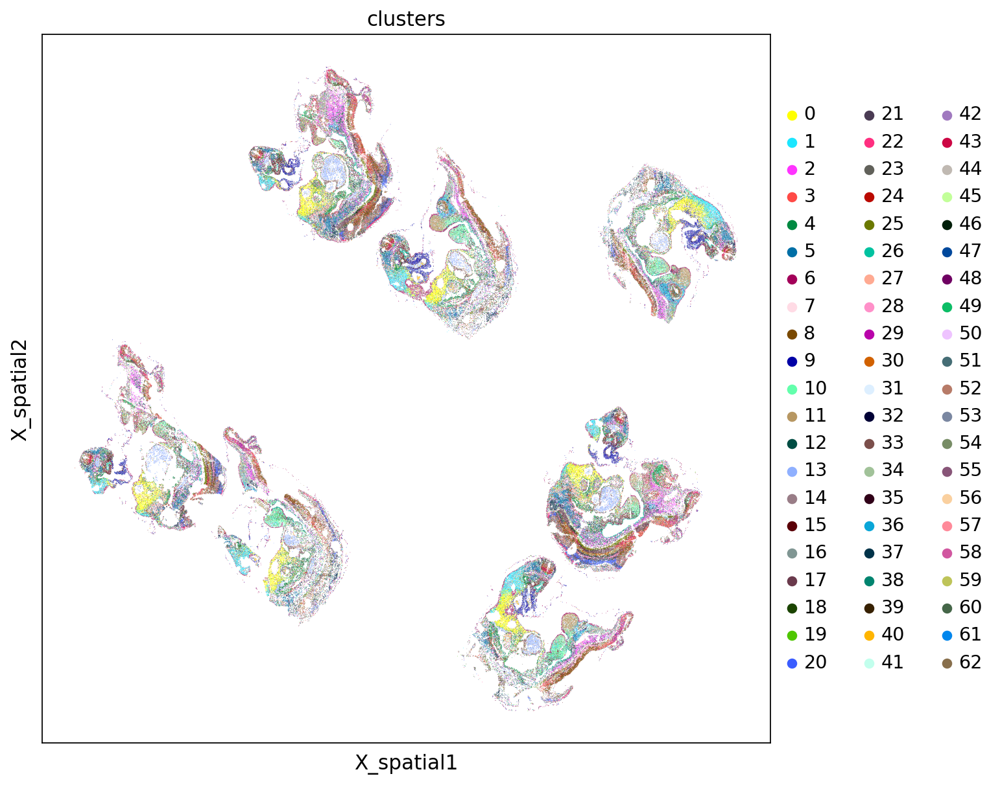

In [6]:
# plot clusters
sc.set_figure_params(figsize=(9,9),facecolor='white')
sc.pl.embedding(adata, basis='X_spatial', color="clusters")

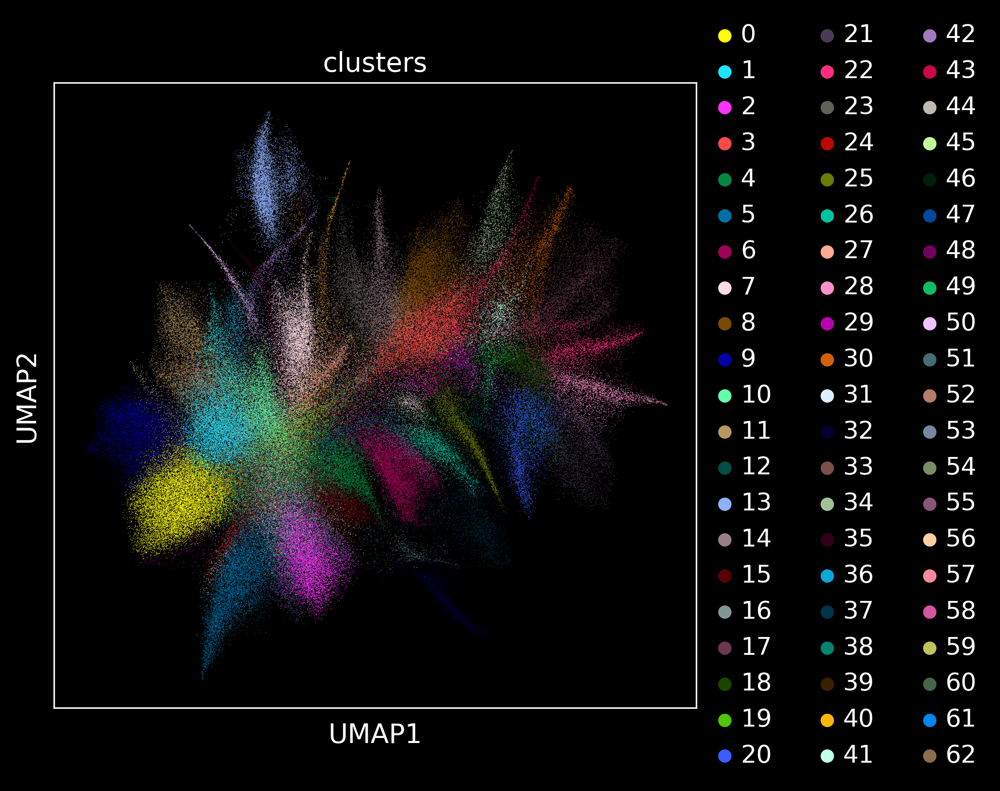

In [7]:
# plot UMAP
sc.set_figure_params(figsize=(6,6), dpi=150)
plt.style.use("dark_background")
sc.pl.umap(adata,color='clusters')

# Clustering and ScTyping

In [8]:
# clustering found using leiden algorithm
M085_clusters = pd.read_csv('./M085_clusters.tsv',sep='\t',index_col='obs_names')

# load and merge the ScType results
sctype_df = pd.read_csv('./ScTypeRerunFeb2024/outputs/20240215_sctype_ct_pred_top2perCluster.SBR.txt',sep='\t',index_col='Unnamed: 0')

sctype_df['num_cells']=sctype_df['cluster'].map(dict(M085_clusters['clusters'].value_counts()))

# low confidence calls are those which have score<numcells/10
sctype_df['high_conf_score']=sctype_df['scores']>sctype_df['num_cells']/10.0


# remove anything with score< 0 or score less than confidence
sctype_df['type'][sctype_df['high_conf_score']==False]='Indeterminate'

# map scores and typing to dataframe
sctype_top = sctype_df.sort_values('scores',ascending=False).drop_duplicates(subset=['cluster'])
sctype_top.index=sctype_top['cluster']
M085_clusters['sctype_pred']=M085_clusters['clusters'].map(dict(sctype_top['type']))
M085_clusters['sctype_pred_score']=M085_clusters['clusters'].map(dict(sctype_top['scores']))
M085_clusters_map = M085_clusters[['clusters','sctype_pred','sctype_pred_score']].drop_duplicates(subset=['clusters'])
M085_clusters_map=M085_clusters_map.sort_values('clusters')
M085_clusters_map.index=M085_clusters_map['clusters']


M085_clusters

,clusters,sc_type,sctype_pred,sctype_pred_score
obs_names,,,,
2187481800038100013,9,DRG,Dorsal Root Ganglia,13022.762877
2187481800038100016,9,DRG,Dorsal Root Ganglia,13022.762877
2187481800038100017,6,DRG,Dorsal Root Ganglia,5075.922890
2187481800038100021,6,DRG,Dorsal Root Ganglia,5075.922890
2187481800038100043,56,DRG,Dorsal Root Ganglia,156.917156
...,...,...,...,...
2187480900139200022,25,NP,Neural Progenitor,7592.894167
2187480900139200031,3,NP,Neural Progenitor,4411.069853
2187480900139200037,40,B,Blood,5433.217645


In [9]:
# genes for cell type identification
marker_df = pd.read_csv('./MarkerGeneAssignment_final.txt',sep='\t',names=['gene','celltype'],index_col='gene')
marker_df.index.astype(str)
marker_df = marker_df.reset_index()
marker_df = marker_df[marker_df['gene'].isin(full_marker_list)]
marker_df = marker_df.groupby('gene').agg(lambda x: ', '.join(x.astype(str)))
marker_df = marker_df.reset_index()
marker_df = marker_df.T
marker_df = marker_df.reset_index()
marker_df = marker_df.set_axis(marker_df.iloc[0], axis=1).drop(0).reset_index(drop=True)
marker_df

,gene,Ascl1,Barhl2,Bhlhe22,Bhlhe23,Car2,Cbln1,Dbx1,Dbx2,Dlx2,...,Sox2,Sp8,Tlx2,Tlx3,Tubb3,Uncx,Vsx1,Vsx2,Wnt1,Zic3
0,celltype,Neuron,Neuron,Neuron,Neuron,Blood,Neuron,Neural progenitor,Neural progenitor,Neural crest,...,Neural progenitor,Neural progenitor,DRG,Neuron,Neuron,Neuron,Neuron,Neuron,Neural progenitor,NCP


In [10]:
M085_clusters['sctype_pred'].value_counts()/(M085_clusters['sctype_pred'].value_counts().sum())

Neural Progenitor      0.192472
Mesoderm               0.180674
Neuron                 0.157301
Dorsal Root Ganglia    0.141894
Indeterminate          0.138497
Pre-EMT-NCP            0.093634
Blood                  0.048001
Neural Crest           0.047527
Name: sctype_pred, dtype: float64

# Plotting of 36 Candidate genes at 0-2 scale

In [20]:
plt.style.use("dark_background")
with PdfPages('regions_colored_by_candidate_grid_0_to_2.pdf') as pdf:
    for z in range(len(MM_DNM_gene_list) // 37 + 1):
        subset_list = MM_DNM_gene_list[z*37:min((z+1)*36,len(MM_DNM_gene_list))]
        fig, axs = plt.subplots(ncols=7, nrows=len(subset_list), figsize=(14,len(subset_list)*2),dpi=500)
        plt.style.use("dark_background")
        for j in range(len(regions_list)):
            adataj = adata[adata.obs['region'] == regions_list[j]]
            for i in range(len(subset_list)):
                transform = transforms.Affine2D().rotate_deg(transform_degrees[regions_list[j]])
                trans_data = transform + axs[i,j].transData
                sc.pl.embedding(adataj, layer='volume_normalized',colorbar_loc = None, basis="X_spatial",ax=axs[i,j],vmin='0', vmax="2", color=subset_list[i], frameon=False,show=False,transform=trans_data)
                if j == 0:
                    fig.text(axs[i,j].get_position().x0-0.01,axs[i,j].get_position().y0 + axs[i,j].get_position().height/2,subset_list[i], style='italic',rotation='vertical',horizontalalignment='center',verticalalignment='center')
                if i == 0:
                    axs[i,j].set_title('region ' + regions_list[j])
                else:
                    axs[i,j].set_title('')
        pdf.savefig(fig, bbox_inches = "tight",dpi=500)
        plt.close(fig)

In [28]:
# scroll pdf to prevent errors 
IFrame('./regions_colored_by_candidate_grid_0_to_2.pdf',width=1050, height=500)

# Individual plots for Marker Gene Scores

In [12]:
for i in markers.keys():
    genes = markers[i]
    sc.tl.score_genes(adata,gene_list = genes, score_name='gene_group_' + i)
plt.style.use("dark_background")
regions_list = ['1_0','2_0','2_1','4_0','4_1','6_1','6_0']
cell_types_list = ['Neuron','Neural progenitor', 'Mesoderm', 'DRG', 'Blood', 'Neural crest', 'Pre-EMT NC progenitor']
with PdfPages('regions_colored_by_marker_group_grid_overlapped.pdf') as pdf:
    fig, axs = plt.subplots(ncols=7, nrows=7, figsize=(14,14),dpi=500)
    for j in range(len(regions_list)):
        adataj = adata[adata.obs['region'] == regions_list[j]]
        for i in range(len(cell_types_list)):
            transform = transforms.Affine2D().rotate_deg(transform_degrees[regions_list[j]])
            trans_data = transform + axs[j,i].transData
            sc.pl.embedding(adataj, colorbar_loc = None, basis="X_spatial",ax=axs[j,i],vmin='0', vmax="0.0005", color='gene_group_' + cell_types_list[i], frameon=False,show=False,transform=trans_data)
            if i == 0:
                fig.text(axs[j,i].get_position().x0-0.01,axs[j,i].get_position().y0 + axs[j,i].get_position().height/2,'region ' + regions_list[j],rotation='vertical',horizontalalignment='center',verticalalignment='center')
            if j == 0:
                axs[j,i].set_title(cell_types_list[i])
            else:
                axs[j,i].set_title('')
    axs[0,6].set_title('NC progenitor')
    plt.show()
    pdf.savefig(fig, bbox_inches = "tight",dpi=500)

# Marker Gene Analysis and Dataframes

In [13]:
# get marker gene data and replace negative expression values to 0
marker_cells = adata.to_df()
marker_cells = marker_cells.filter(full_marker_list, axis=1)
convert = marker_cells.columns[1:]
marker_cells[convert] = marker_cells[convert].astype(float)

marker_cells = marker_cells.applymap(positive)
marker_cells.index = marker_cells.index.astype(int)
marker_cells = pd.merge(M085_clusters, marker_cells, left_index=True, right_index=True)
marker_cells = marker_cells.drop(['clusters','sctype_pred_score', 'sc_type'], axis = 1)
marker_cells = marker_cells.set_index('sctype_pred')
marker_cells = marker_cells.reset_index()
convert = marker_cells.columns[1:]
marker_cells[convert] = marker_cells[convert].astype(float)
marker_clusters = marker_cells.groupby('sctype_pred').mean()
percent_avg_exp_marker = (marker_clusters.div(marker_clusters.sum(axis=0), axis=1) * 100)
percent_avg_exp_marker = percent_avg_exp_marker.reset_index()
#percent_avg_exp_marker.to_csv('Marker_percent_avg.tsv',sep='\t',index=False)

percent_avg_exp_marker

,sctype_pred,Klf1,Hemgn,Car2,Sox17,Fermt3,Tlx2,Krt8,Foxc1,Foxc2,...,Evx1,Vsx2,Sox14,Vsx1,Onecut2,Pou2f2,Tubb3,Elavl3,Zic3,Mafb
0,Blood,85.430477,94.434210,87.016747,46.872664,70.849143,1.226626,5.927960,8.302483,9.287615,...,9.013313,1.883905,3.787424,3.355414,3.929283,3.478080,2.240464,1.850238,4.167413,6.724055
1,Dorsal Root Ganglia,1.688205,0.513004,1.618142,5.760394,4.016260,64.060727,68.297592,2.973960,3.377694,...,4.642568,2.715242,14.179361,2.954297,2.236719,2.797000,3.488135,3.144898,4.298220,8.380639
2,Indeterminate,2.855065,1.581815,2.344489,5.774557,3.744933,3.121539,4.502557,8.053670,7.948465,...,16.860627,2.312175,3.199796,2.939459,4.675631,3.717670,3.282088,3.705078,5.166830,6.870221
3,Mesoderm,1.659024,0.435365,1.491387,5.252797,3.674005,3.263150,2.179177,50.030386,47.259221,...,2.281474,3.046827,2.996320,2.698269,2.441254,2.499142,1.334151,0.955001,4.974638,11.100774
4,Neural Crest,1.910308,0.295795,1.149736,6.533619,4.324631,13.128925,1.483871,8.681581,9.304261,...,2.327151,3.201303,2.913525,3.569959,2.733990,4.408585,11.480023,7.264812,7.220770,7.735413
5,Neural Progenitor,1.913226,0.487996,1.613159,6.510508,3.631825,4.363478,8.279952,3.680633,3.018080,...,4.489328,7.416304,6.098194,2.786143,7.109402,8.240401,9.334194,17.787413,5.498444,8.475022
6,Neuron,2.676261,0.771240,1.445481,8.624255,3.790169,6.448540,1.889479,2.984415,2.788149,...,56.788352,76.220707,63.947140,78.413108,73.407493,71.918900,67.137723,63.957566,7.180276,13.089072
7,Pre-EMT-NCP,1.867434,1.480574,3.320860,14.671206,5.969033,4.387016,7.439411,15.292872,17.016515,...,3.597187,3.203536,2.878241,3.283352,3.466227,2.940222,1.703222,1.334994,61.493409,37.624804


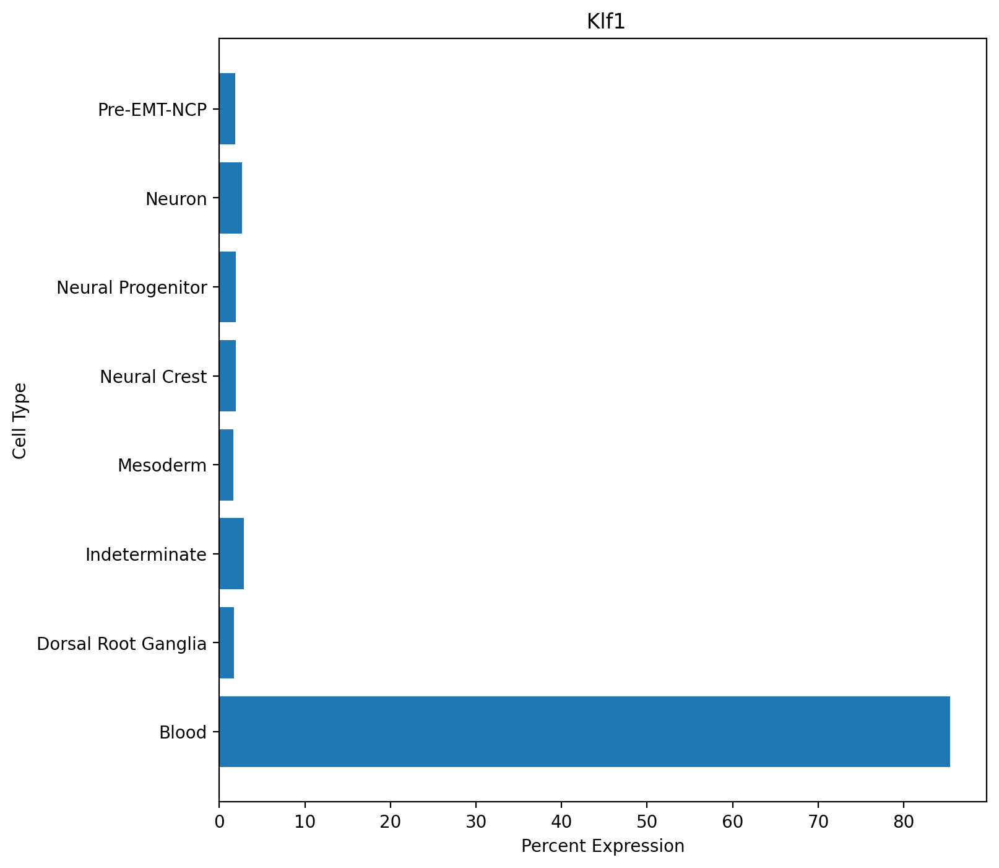

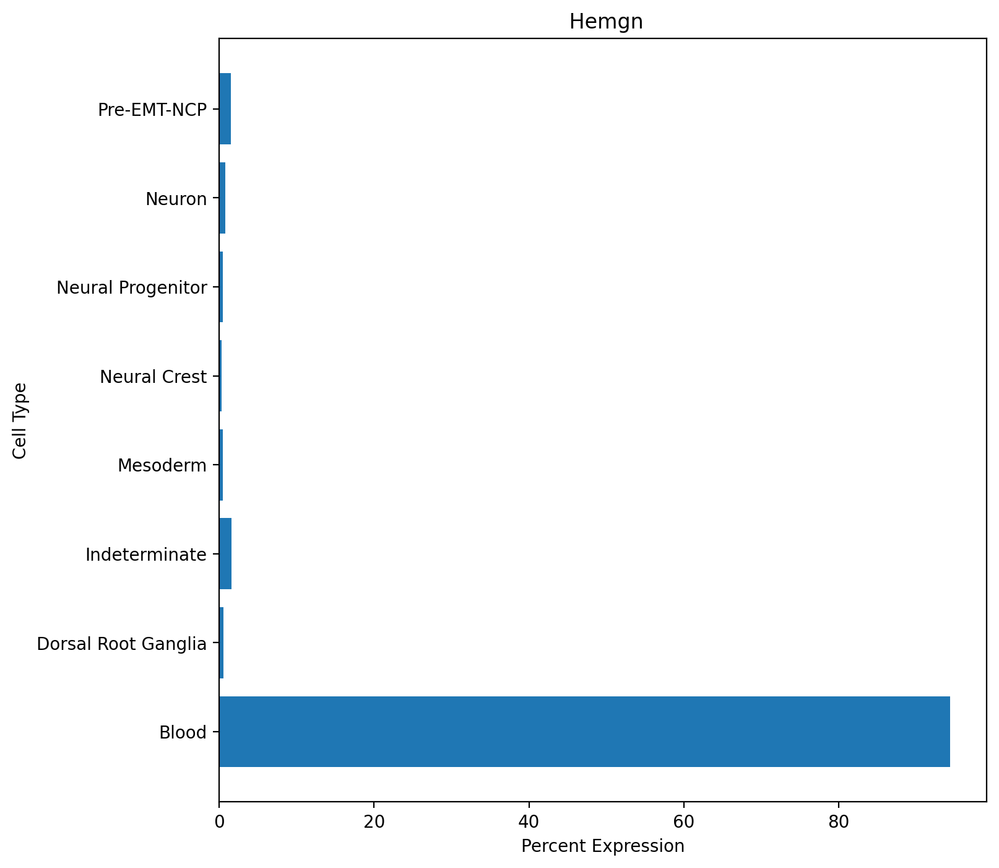

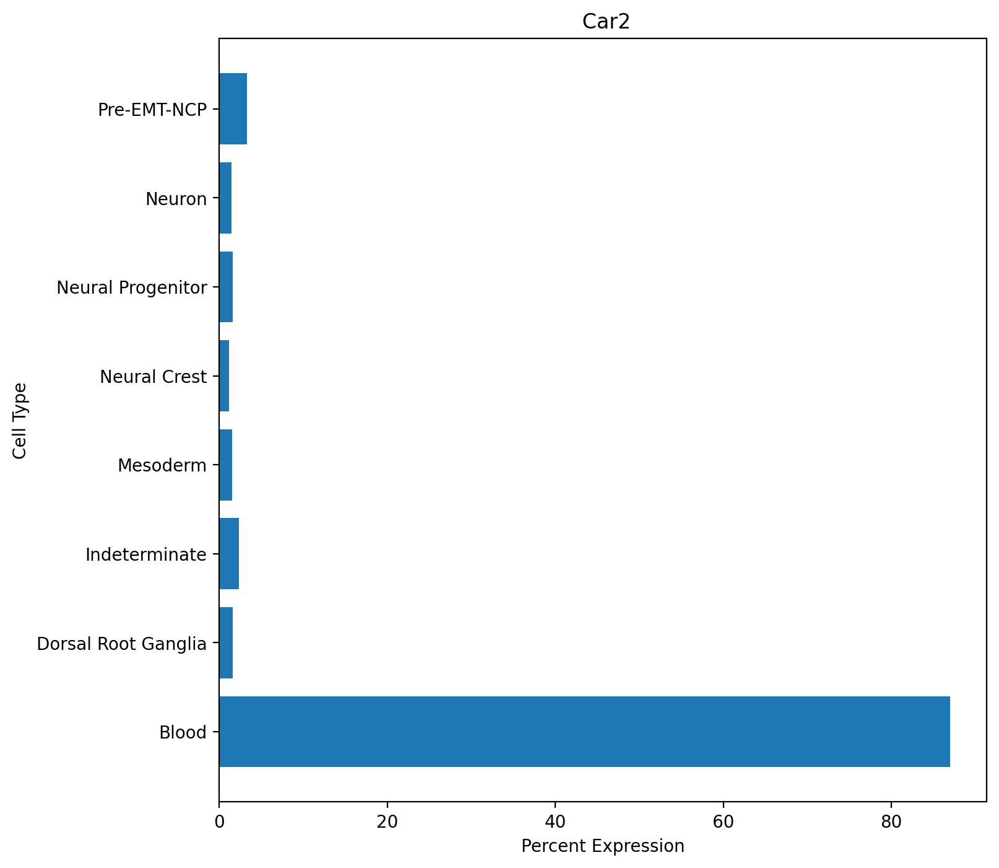

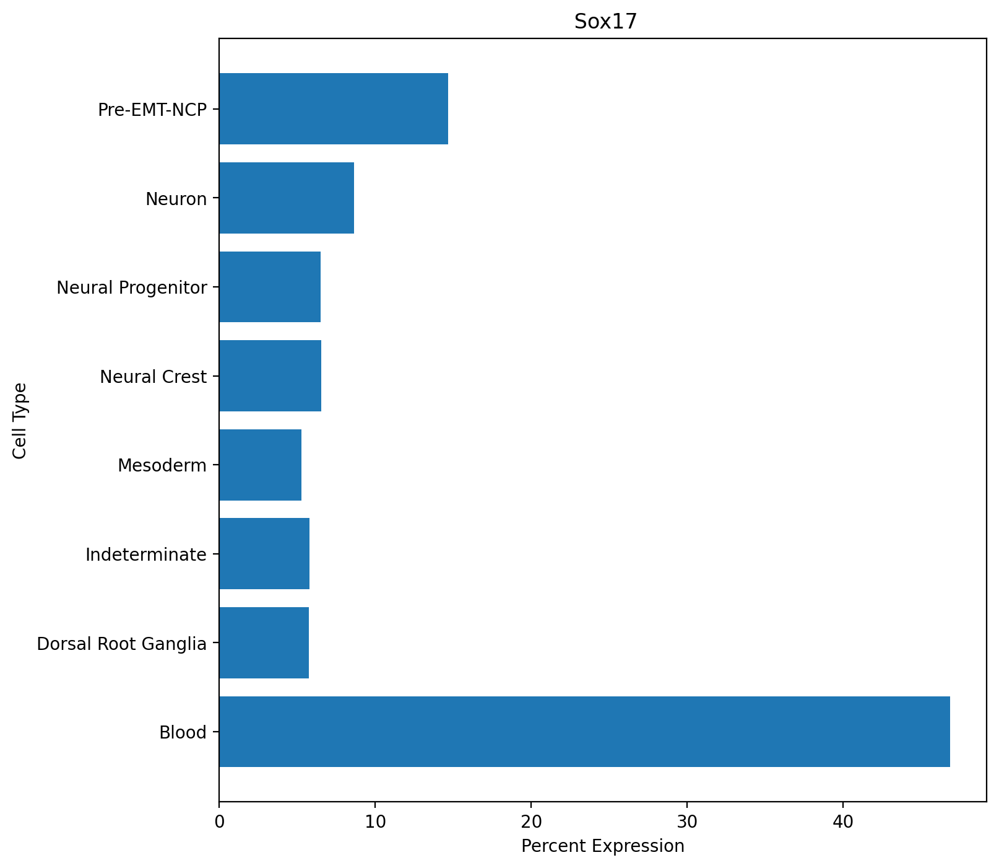

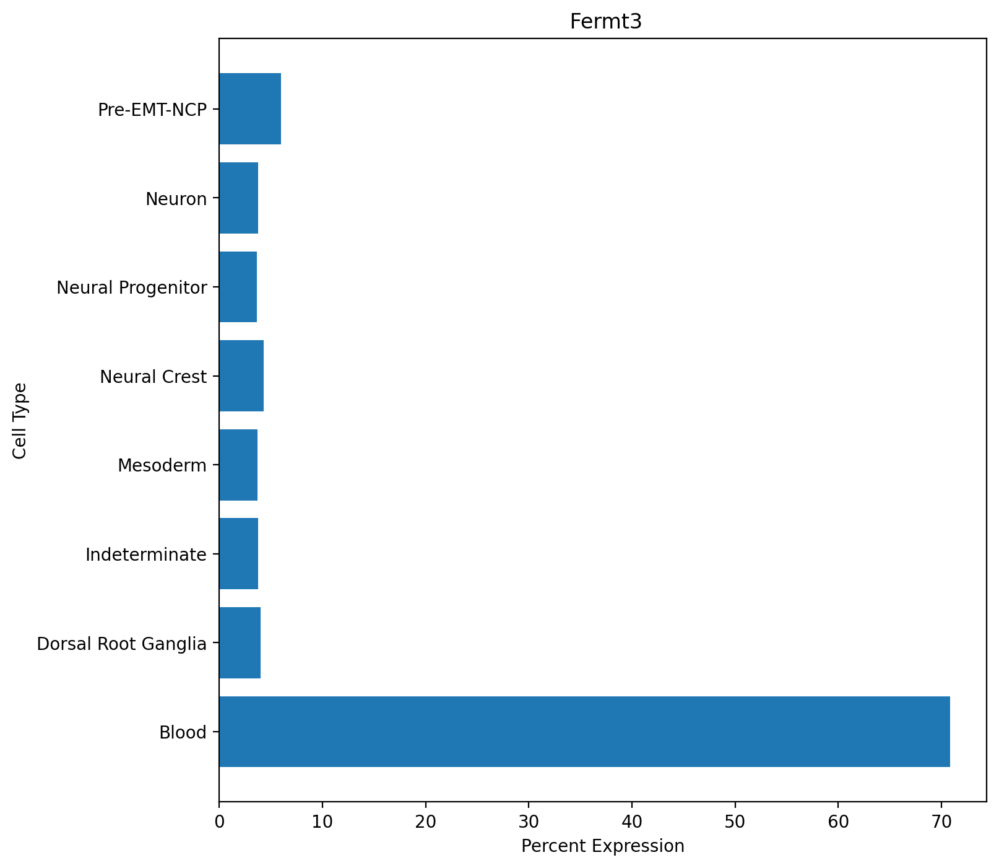

...

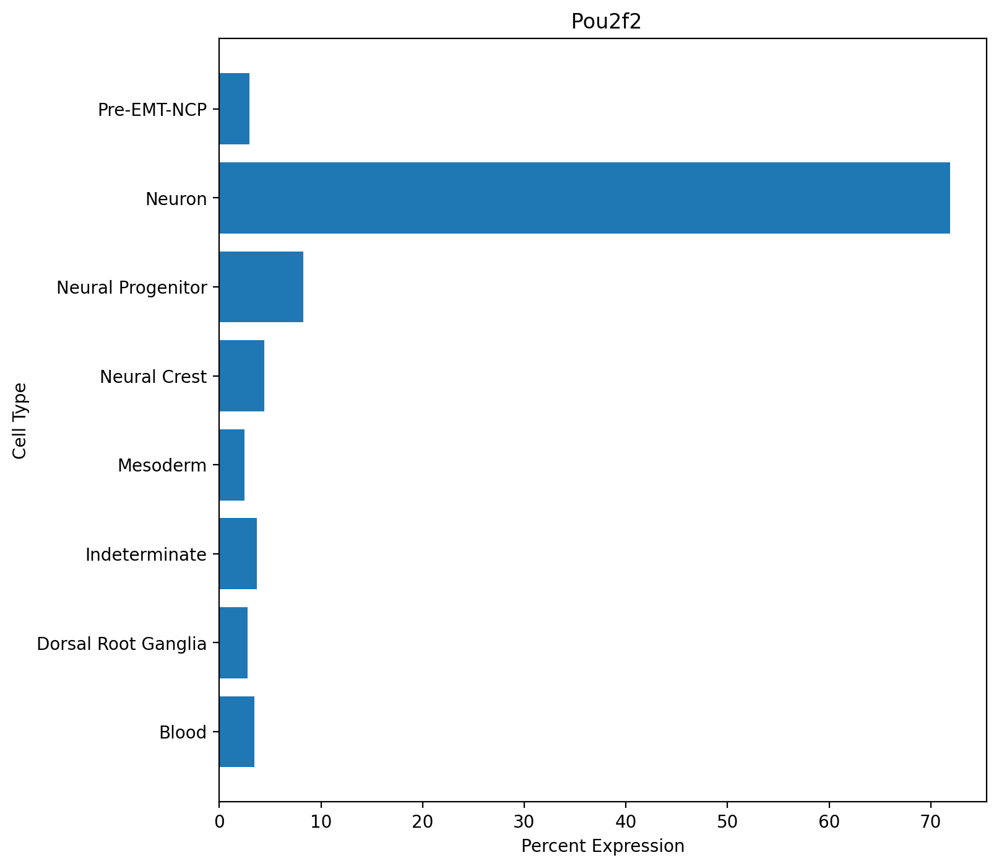

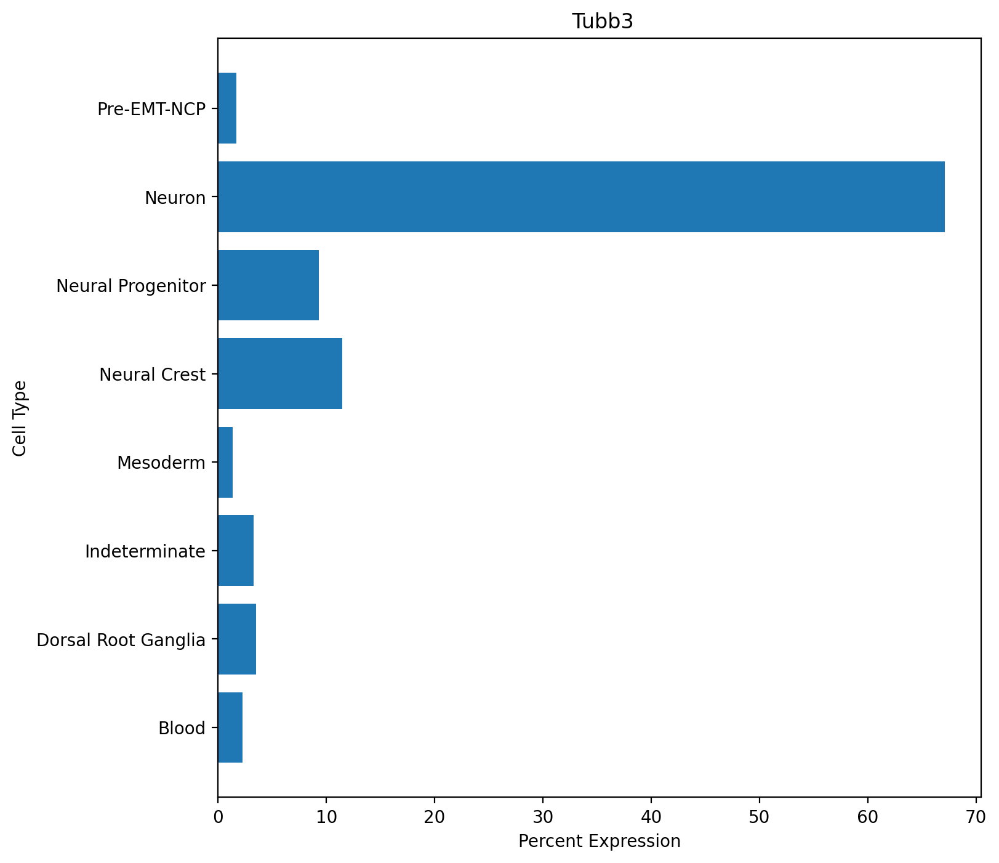

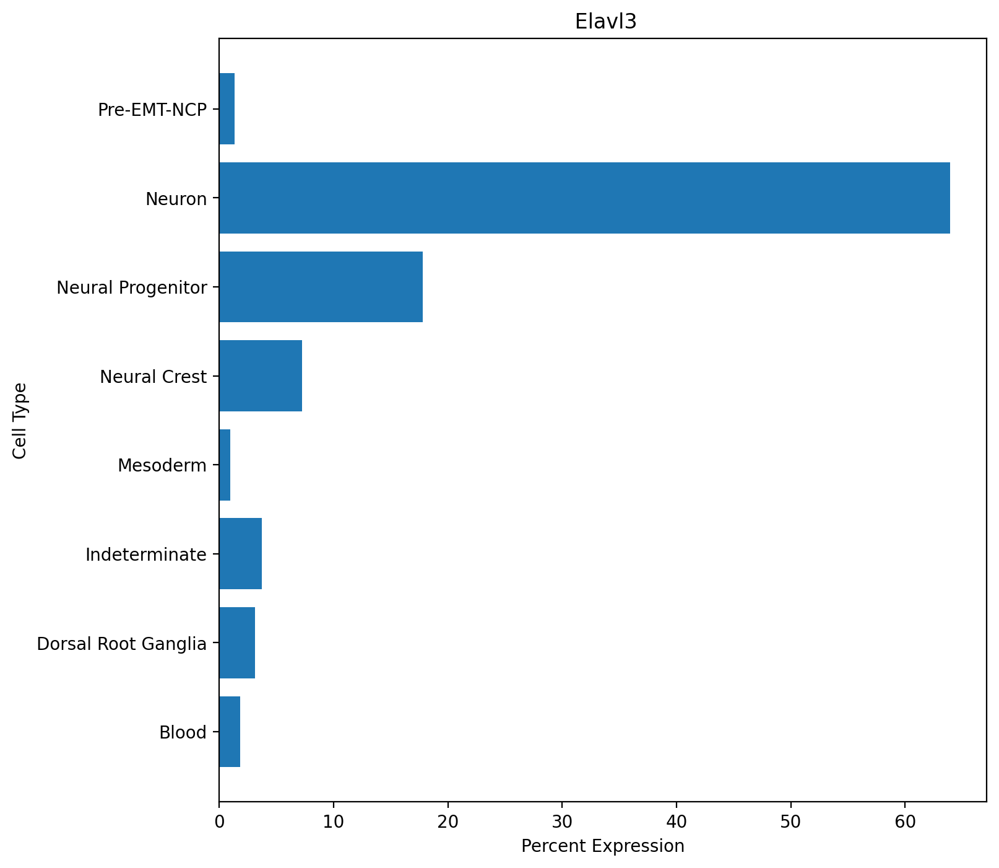

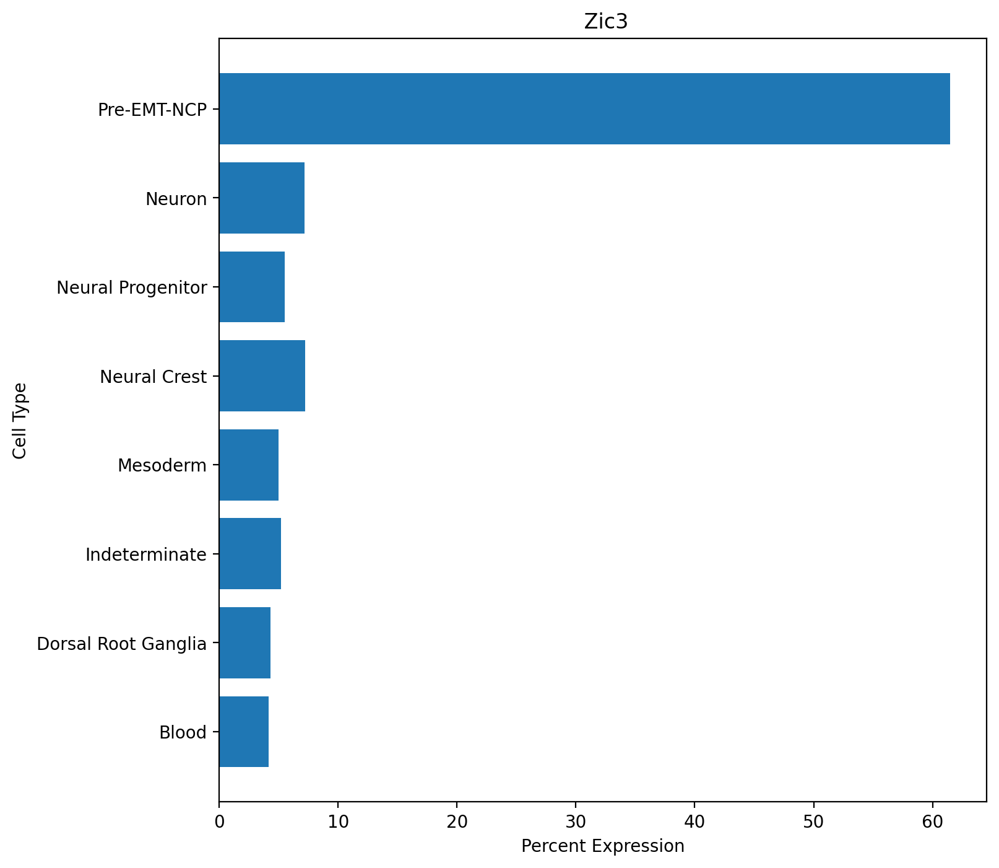

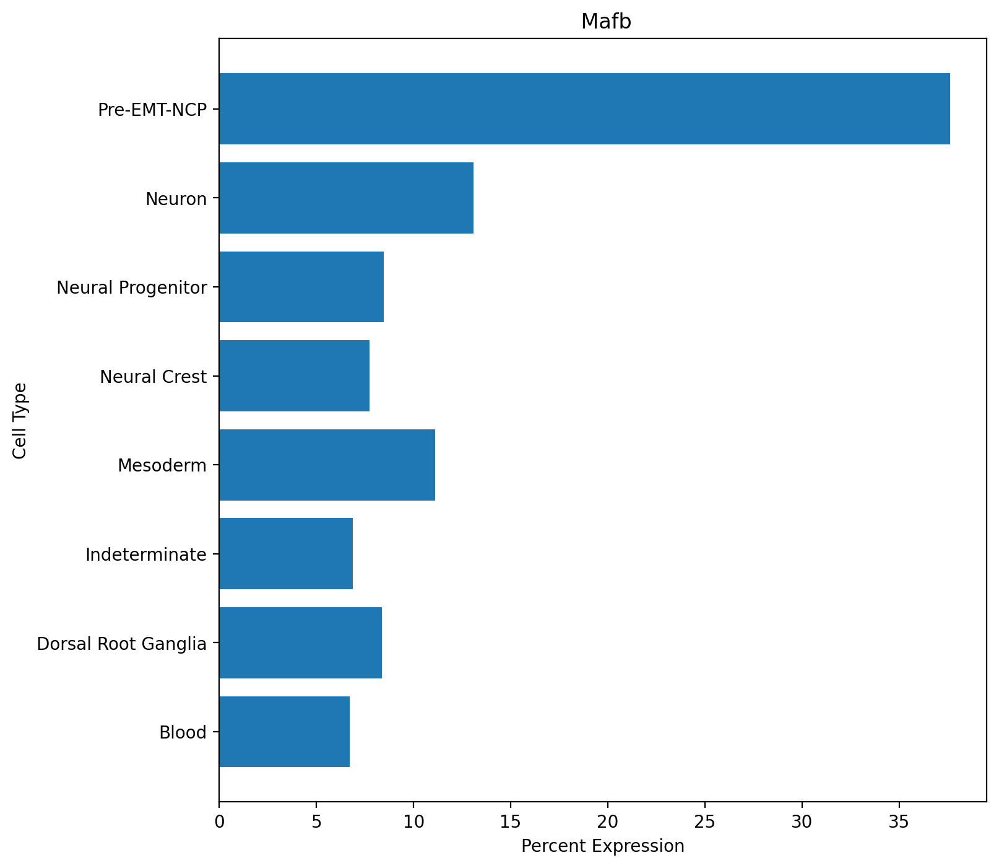

In [14]:
# percent expression per marker gene
#with PdfPages('Marker_percent_expression.pdf') as pdf:
plt.style.use('default')
for gene_column in percent_avg_exp_marker.columns[1:]:
    plt.figure(figsize=(8, 8))
    plt.barh(percent_avg_exp_marker['sctype_pred'], percent_avg_exp_marker[gene_column])
    plt.xlabel('Percent Expression')
    plt.ylabel('Cell Type')
    plt.title(f' {gene_column}')
        #pdf.savefig()
    plt.show()
    plt.close()

In [15]:
# final typing with gene expression
percent_markers_typing = pd.concat([percent_avg_exp_marker, marker_df], ignore_index=True)
percent_markers_typing

,sctype_pred,Klf1,Hemgn,Car2,Sox17,Fermt3,Tlx2,Krt8,Foxc1,Foxc2,...,Vsx2,Sox14,Vsx1,Onecut2,Pou2f2,Tubb3,Elavl3,Zic3,Mafb,gene
0,Blood,85.430477,94.43421,87.016747,46.872664,70.849143,1.226626,5.92796,8.302483,9.287615,...,1.883905,3.787424,3.355414,3.929283,3.47808,2.240464,1.850238,4.167413,6.724055,NaN
1,Dorsal Root Ganglia,1.688205,0.513004,1.618142,5.760394,4.01626,64.060727,68.297592,2.97396,3.377694,...,2.715242,14.179361,2.954297,2.236719,2.797,3.488135,3.144898,4.29822,8.380639,NaN
2,Indeterminate,2.855065,1.581815,2.344489,5.774557,3.744933,3.121539,4.502557,8.05367,7.948465,...,2.312175,3.199796,2.939459,4.675631,3.71767,3.282088,3.705078,5.16683,6.870221,NaN
3,Mesoderm,1.659024,0.435365,1.491387,5.252797,3.674005,3.26315,2.179177,50.030386,47.259221,...,3.046827,2.99632,2.698269,2.441254,2.499142,1.334151,0.955001,4.974638,11.100774,NaN
4,Neural Crest,1.910308,0.295795,1.149736,6.533619,4.324631,13.128925,1.483871,8.681581,9.304261,...,3.201303,2.913525,3.569959,2.73399,4.408585,11.480023,7.264812,7.22077,7.735413,NaN
5,Neural Progenitor,1.913226,0.487996,1.613159,6.510508,3.631825,4.363478,8.279952,3.680633,3.01808,...,7.416304,6.098194,2.786143,7.109402,8.240401,9.334194,17.787413,5.498444,8.475022,NaN
6,Neuron,2.676261,0.77124,1.445481,8.624255,3.790169,6.44854,1.889479,2.984415,2.788149,...,76.220707,63.94714,78.413108,73.407493,71.9189,67.137723,63.957566,7.180276,13.089072,NaN
7,Pre-EMT-NCP,1.867434,1.480574,3.32086,14.671206,5.969033,4.387016,7.439411,15.292872,17.016515,...,3.203536,2.878241,3.283352,3.466227,2.940222,1.703222,1.334994,61.493409,37.624804,NaN
8,NaN,Blood,Blood,Blood,Blood,Blood,DRG,DRG,Mesoderm,Mesoderm,...,Neuron,Neuron,Neuron,Neuron,Neuron,Neuron,Neuron,NCP,NCP,celltype


# DNM candidate analysis Figures and Dataframes

In [16]:
# get DNM gene data and replace negative expression values to 0
DNM_cells = adata.to_df()
DNM_cells = DNM_cells.filter(MM_DNM_gene_list, axis=1)
convert = DNM_cells.columns[1:]
DNM_cells[convert] = DNM_cells[convert].astype(float)

DNM_cells = DNM_cells.applymap(positive)
DNM_cells.index = DNM_cells.index.astype(int)
DNM_cells = pd.merge(M085_clusters, DNM_cells, left_index=True, right_index=True)
DNM_cells = DNM_cells.drop(['clusters','sctype_pred_score', 'sc_type'], axis = 1)
DNM_cells = DNM_cells.set_index('sctype_pred')
DNM_cells = DNM_cells.reset_index()
convert = DNM_cells.columns[1:]
DNM_cells[convert] = DNM_cells[convert].astype(float)
DNM_clusters = DNM_cells.groupby('sctype_pred').mean()
percent_avg_exp_DNM = (DNM_clusters.div(DNM_clusters.sum(axis=0), axis=1) * 100)
percent_avg_exp_DNM = percent_avg_exp_DNM.reset_index()
#percent_avg_exp_DNM.to_csv('DNM_percent_avg.tsv',sep='\t',index=False)

percent_avg_exp_DNM

,sctype_pred,Add2,Atg10,Bicra,Celsr1,Chordc1,Cnpy1,Ehd4,Evl,Fam83g,...,Slain2,Smurf2,Spen,Spx,Stab1,Tcf12,Unc80,Whamm,Xirp2,Zswim6
0,Blood,40.180263,12.008340,10.332310,6.493483,8.237434,7.801731,28.029948,6.857074,10.422137,...,15.576960,10.096715,22.794819,11.993781,8.869188,8.188223,18.368526,27.895985,3.583696,9.646611
1,Dorsal Root Ganglia,2.413290,9.732275,9.800242,15.763690,15.225585,10.270629,9.808070,15.993213,26.347910,...,12.925519,13.958762,7.828127,9.957943,2.057873,12.532072,10.533415,6.998970,7.884691,7.802563
2,Indeterminate,4.568789,22.088098,15.013059,12.608992,12.645735,35.236731,12.274696,12.699294,10.019164,...,14.255273,13.753956,11.410218,16.571319,2.116958,15.549378,19.752033,20.206706,42.636468,10.233184
3,Mesoderm,2.445272,9.211373,11.833452,4.842894,13.623870,6.539594,10.321281,11.918446,9.665092,...,12.187326,12.174026,8.949079,14.296794,2.243857,12.651902,8.712808,6.462890,5.694495,10.502352
4,Neural Crest,5.169284,11.396359,13.859034,6.912746,13.370583,5.784231,6.977551,15.916325,10.538580,...,11.097222,15.498822,13.537502,11.380416,1.486965,13.288531,12.060133,11.120234,13.349438,12.285834
5,Neural Progenitor,7.797700,9.885026,14.115324,34.419892,9.480557,11.717694,7.053474,9.839774,14.070223,...,9.604590,9.659045,14.817327,10.265947,1.697977,12.396660,9.828693,9.060930,7.211396,13.753928
6,Neuron,34.247096,11.263325,12.848986,8.050787,10.673403,17.008712,4.484056,13.556465,8.552584,...,10.152820,10.055177,10.370142,11.586050,1.840930,12.050688,13.721857,8.257538,12.640501,21.666004
7,Pre-EMT-NCP,3.178306,14.415203,12.197593,10.907515,16.742833,5.640678,21.050924,13.219408,10.384311,...,14.200290,14.803497,10.292787,13.947749,79.686253,13.342545,7.022534,9.996747,6.999314,14.109523


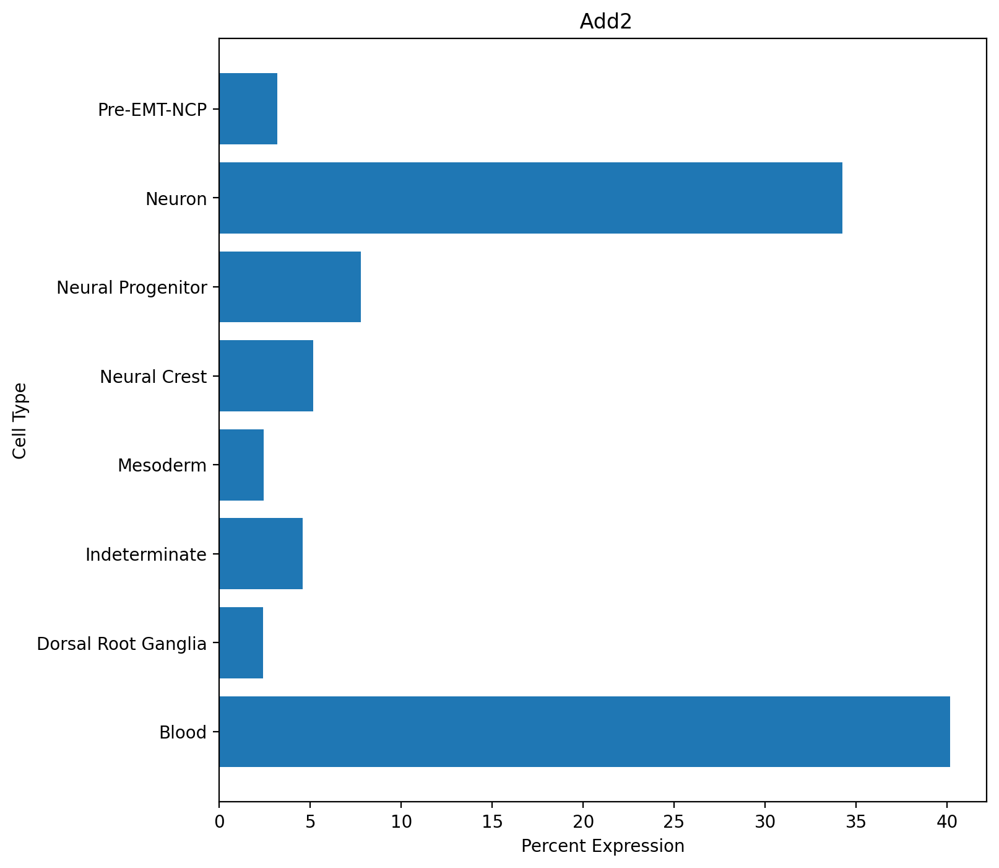

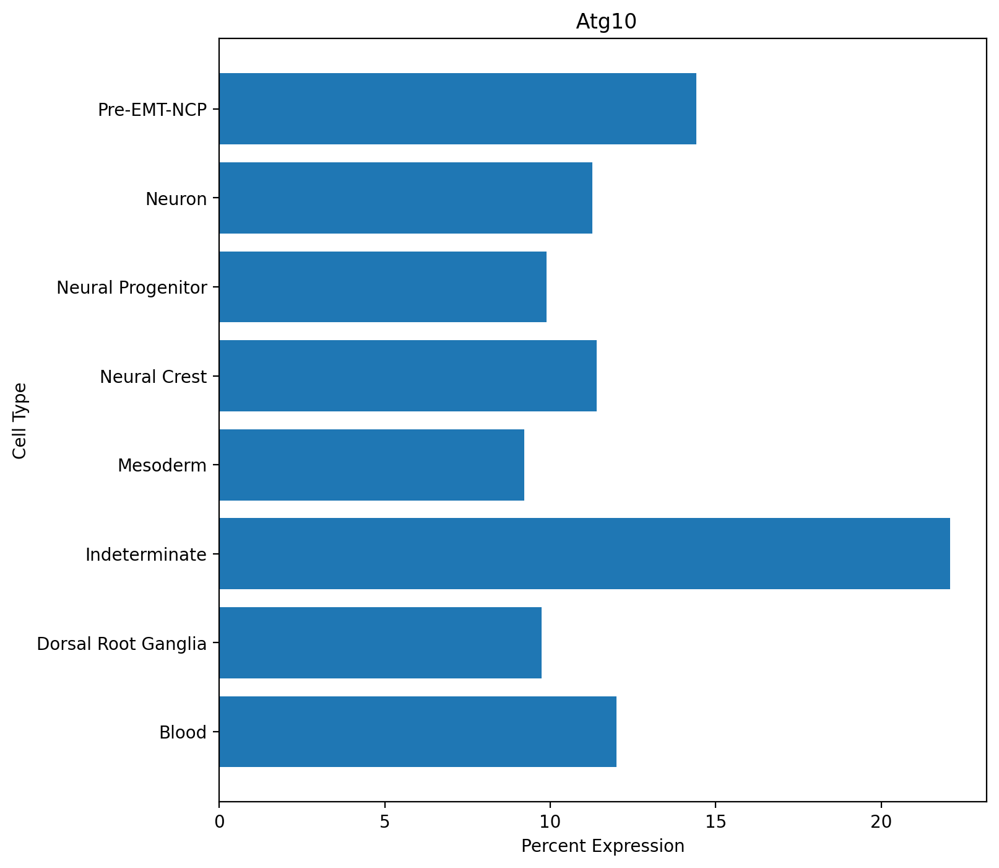

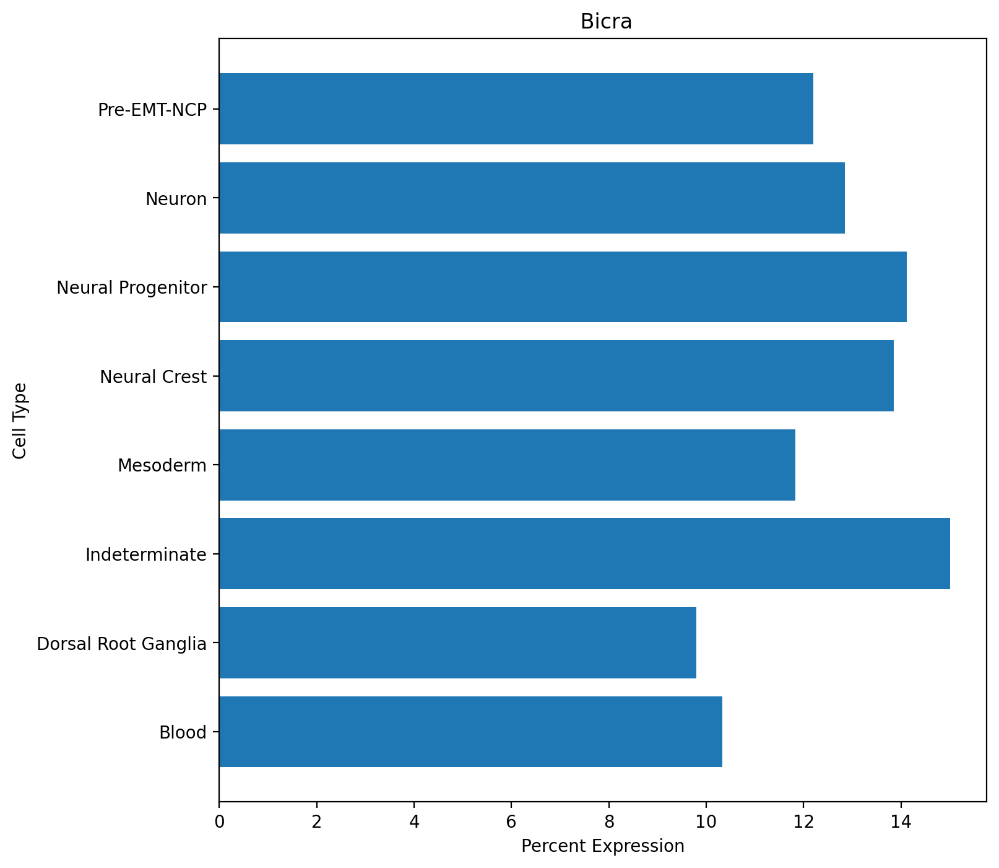

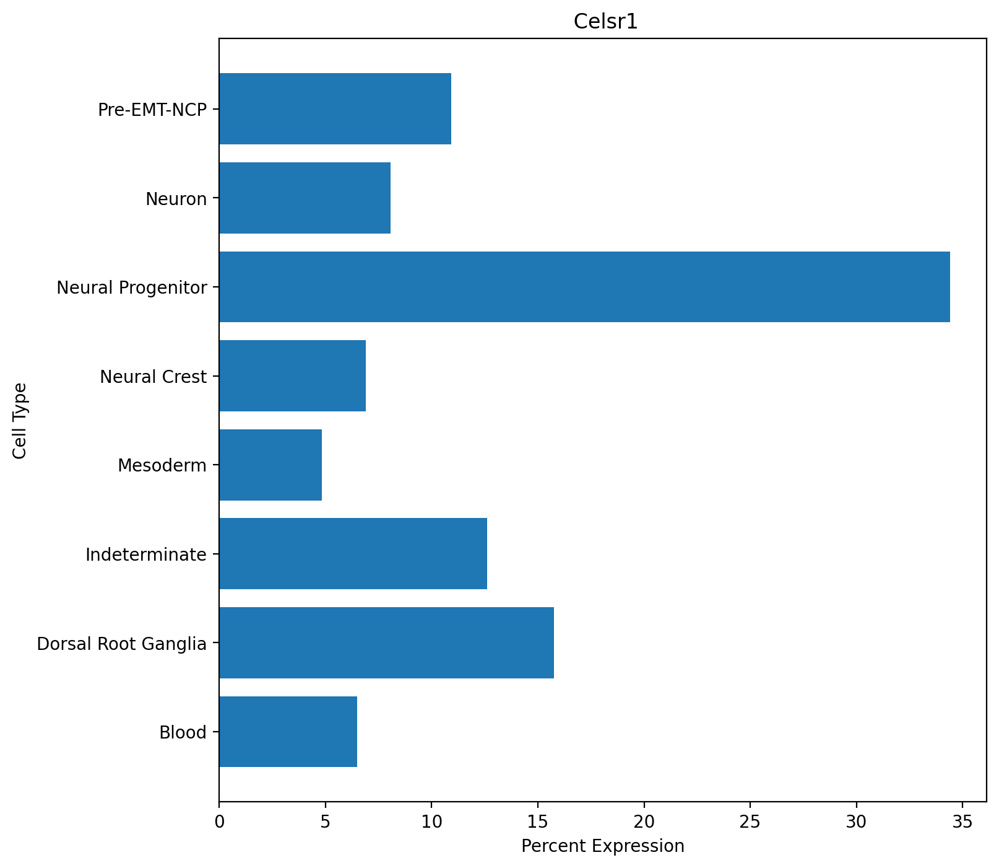

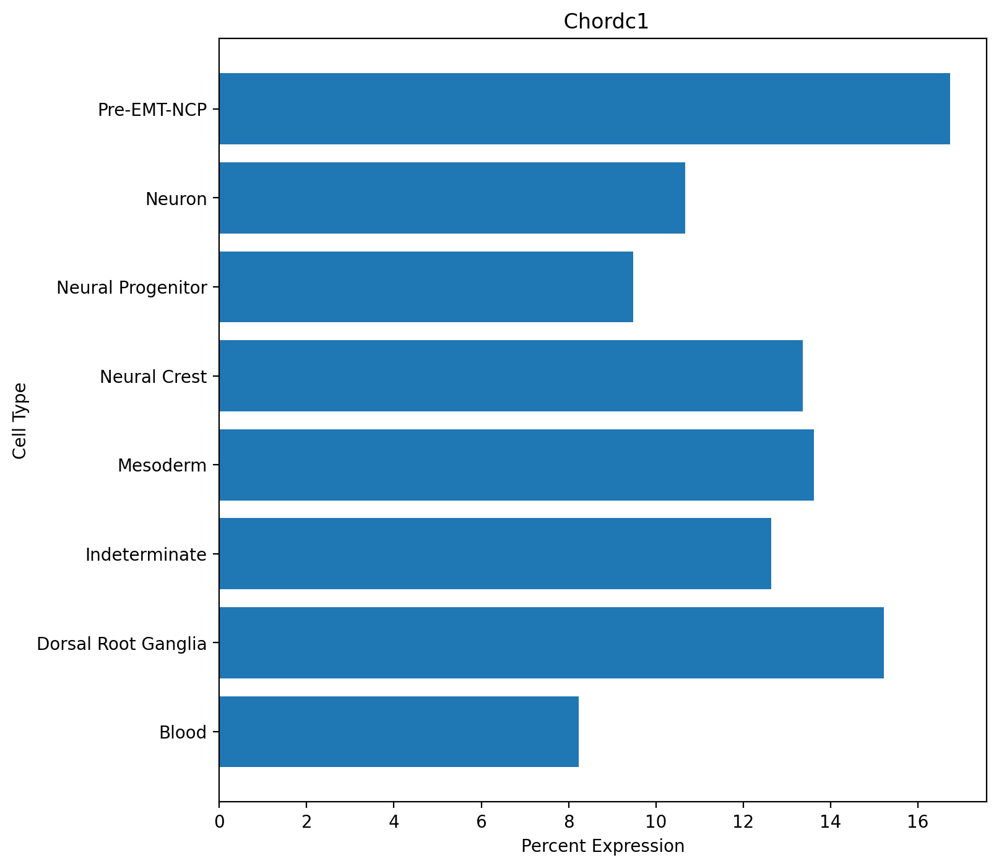

...

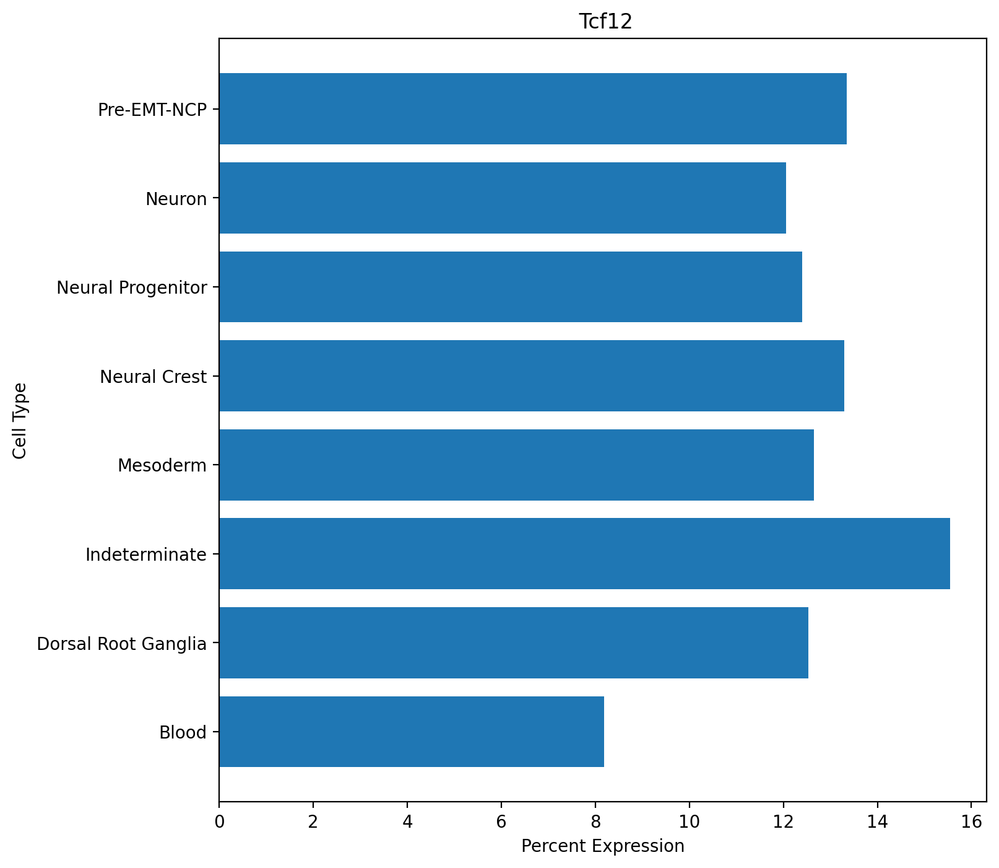

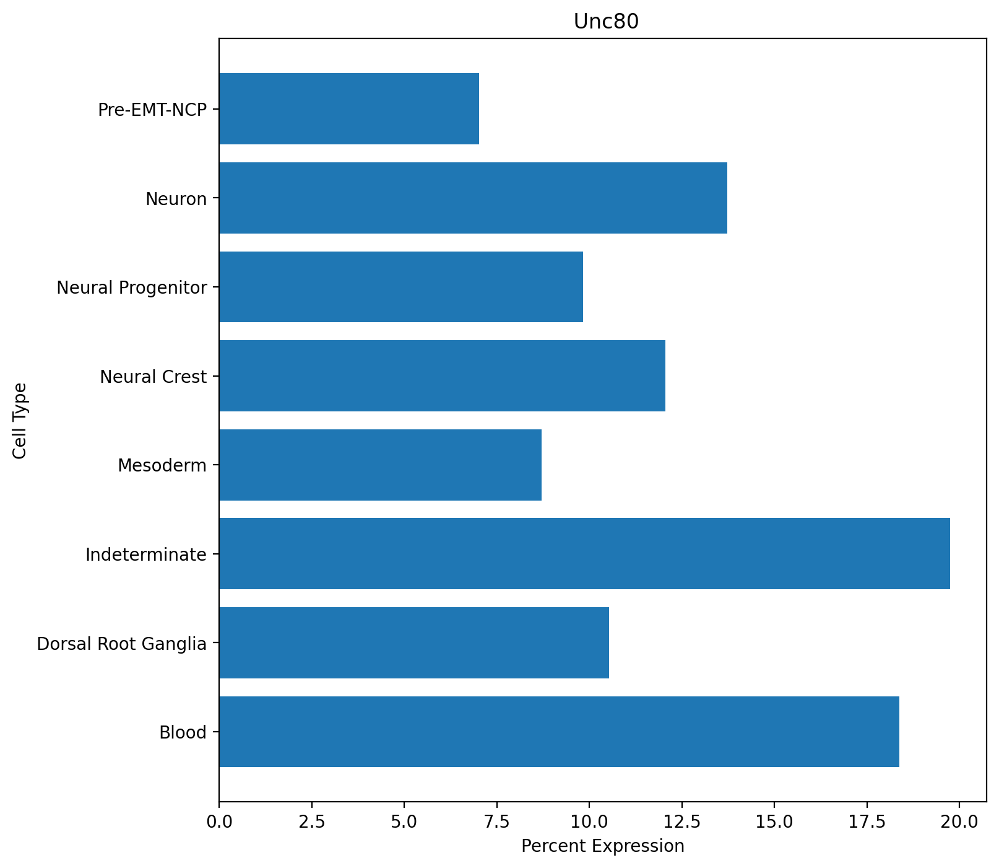

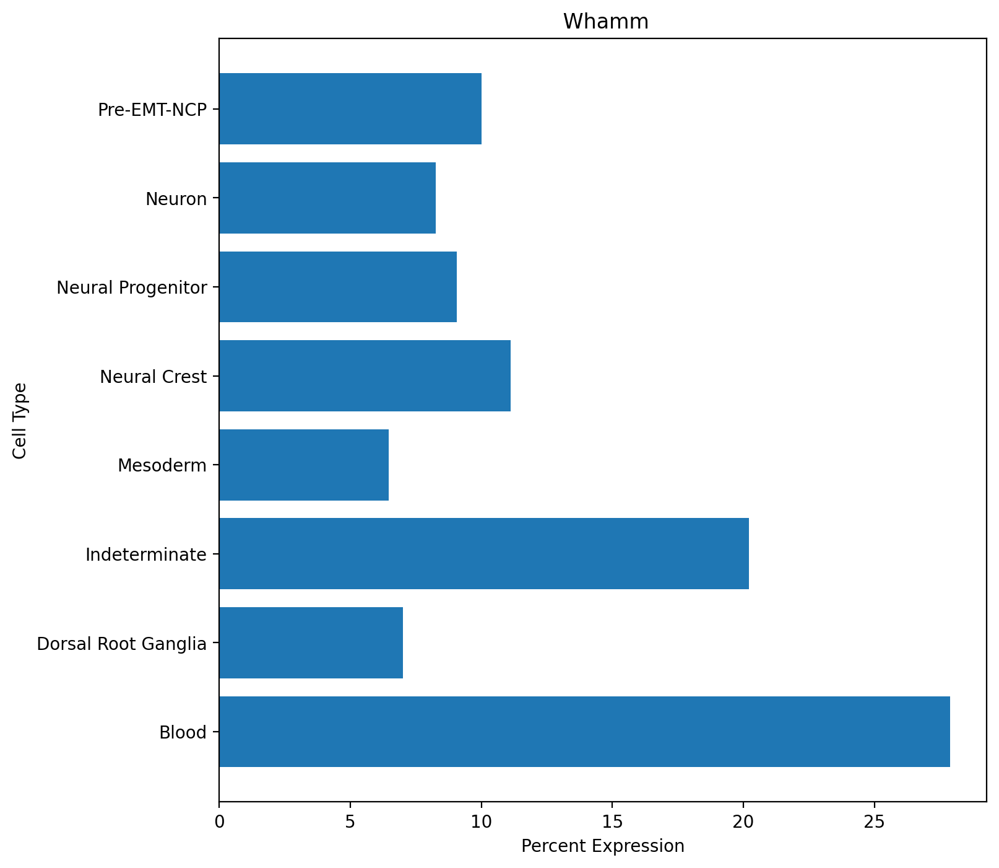

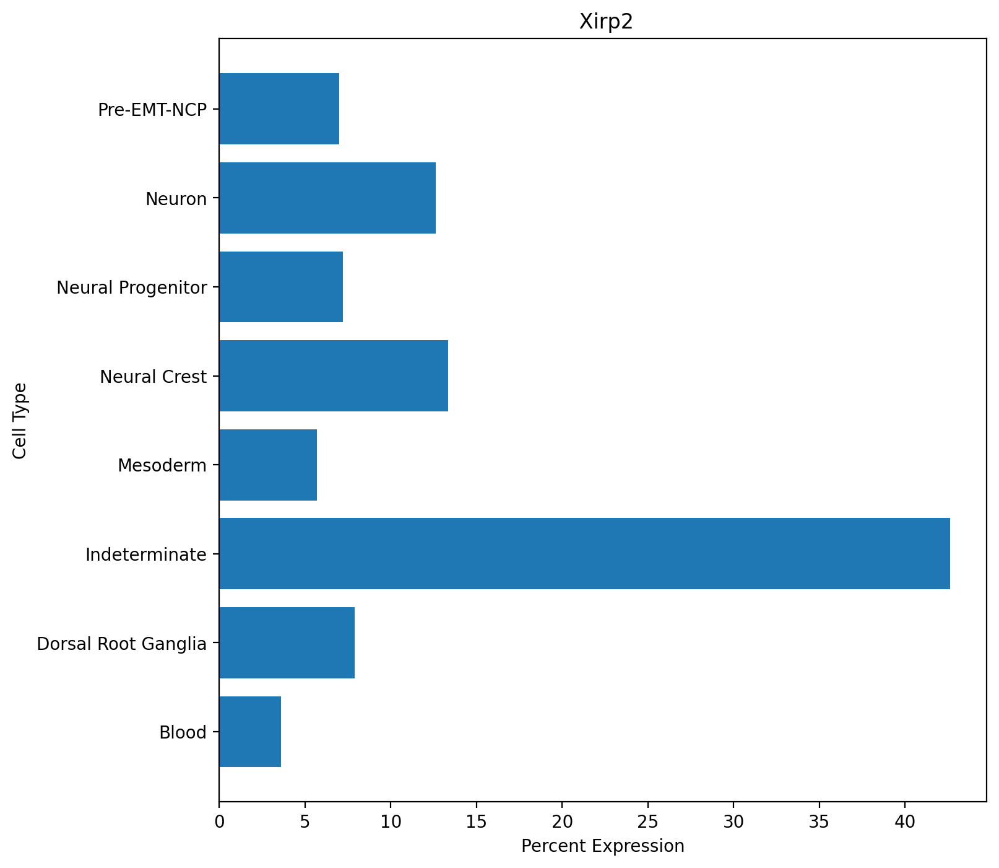

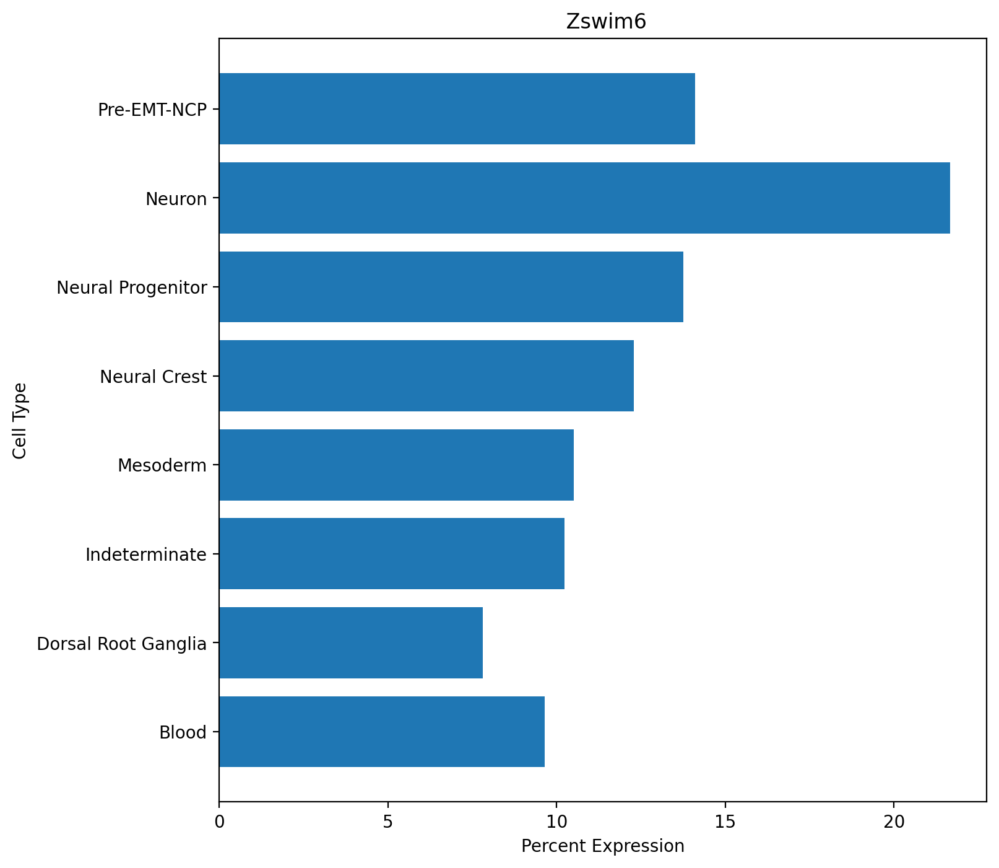

In [17]:
# percent expression per DNM gene
#with PdfPages('DNM_percent_expression.pdf') as pdf:
for gene_column in percent_avg_exp_DNM.columns[1:]:
    plt.figure(figsize=(8, 8))
    plt.barh(percent_avg_exp_DNM['sctype_pred'], percent_avg_exp_DNM[gene_column])
    plt.xlabel('Percent Expression')
    plt.ylabel('Cell Type')
    plt.title(f' {gene_column}')
        #pdf.savefig()
    plt.show()
    plt.close()
